##### Copyright 2023 The MediaPipe Authors. All Rights Reserved.

In [ ]:
#@title Licensed under the Apache License, Version 2.0 (the "License");
# you may not use this file except in compliance with the License.
# You may obtain a copy of the License at
#
# https://www.apache.org/licenses/LICENSE-2.0
#
# Unless required by applicable law or agreed to in writing, software
# distributed under the License is distributed on an "AS IS" BASIS,
# WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
# See the License for the specific language governing permissions and
# limitations under the License.

# Pose Landmarks Detection with MediaPipe Tasks

This notebook shows you how to use MediaPipe Tasks Python API to detect pose landmarks from images.

## Preparation

Let's start with installing MediaPipe.


In [ ]:
!pip install -q mediapipe

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.6/35.6 MB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 38.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 41.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 37.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 10.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.2/124.2 MB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 196.0/196.0 MB 5.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 166.0/166.0 MB 7.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 11.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━

Then download an off-the-shelf model bundle. Check out the [MediaPipe documentation](https://developers.google.com/mediapipe/solutions/vision/pose_landmarker#models) for more information about this model bundle.

In [ ]:
!wget -O pose_landmarker.task -q https://storage.googleapis.com/mediapipe-models/pose_landmarker/pose_landmarker_heavy/float16/1/pose_landmarker_heavy.task

## Visualization utilities

In [ ]:
# To better demonstrate the Pose Landmarker API, we have created a set of visualization tools that will be used in this colab. These will draw the landmarks on a detect person, as well as the expected connections between those markers.

from mediapipe import solutions
from mediapipe.framework.formats import landmark_pb2
import numpy as np


def draw_landmarks_on_image(rgb_image, detection_result):
  pose_landmarks_list = detection_result.pose_landmarks
  annotated_image = np.copy(rgb_image)

  # Loop through the detected poses to visualize.
  for idx in range(len(pose_landmarks_list)):
    pose_landmarks = pose_landmarks_list[idx]

    # Draw the pose landmarks.
    pose_landmarks_proto = landmark_pb2.NormalizedLandmarkList()
    pose_landmarks_proto.landmark.extend([
      landmark_pb2.NormalizedLandmark(x=landmark.x, y=landmark.y, z=landmark.z) for landmark in pose_landmarks
    ])
    solutions.drawing_utils.draw_landmarks(
      annotated_image,
      pose_landmarks_proto,
      solutions.pose.POSE_CONNECTIONS,
      solutions.drawing_styles.get_default_pose_landmarks_style())
  return annotated_image

## Download test image

To demonstrate the Pose Landmarker API, you can download a sample image using the follow code. The image is from [Pixabay](https://pixabay.com/photos/girl-woman-fitness-beautiful-smile-4051811/).

Optionally, you can upload your own image. If you want to do so, uncomment and run the cell below.

In [ ]:
from google.colab import files
uploaded = files.upload()

for filename in uploaded:
  content = uploaded[filename]
  with open(filename, 'wb') as f:
    f.write(content)

if len(uploaded.keys()):
  IMAGE_FILE = next(iter(uploaded))
  print('Uploaded file:', IMAGE_FILE)

Saving video1.mp4 to video1.mp4
Uploaded file: video1.mp4


In [ ]:
import cv2
import mediapipe as mp
import math
cap = cv2.VideoCapture('video1.mp4')

In [ ]:
fps = cap.get(cv2.CAP_PROP_FPS)
print("Frames per second using video.get(cv2.CAP_PROP_FPS) : {0}".format(fps))

Frames per second using video.get(cv2.CAP_PROP_FPS) : 30.0


image size:  (544, 960, 3)
points_x_11:  582
points_y_11:  204
points_x_12:  512
points_y_12:  203
points_x_27:  565
points_y_27:  476
points_x_28:  499
points_y_28:  470


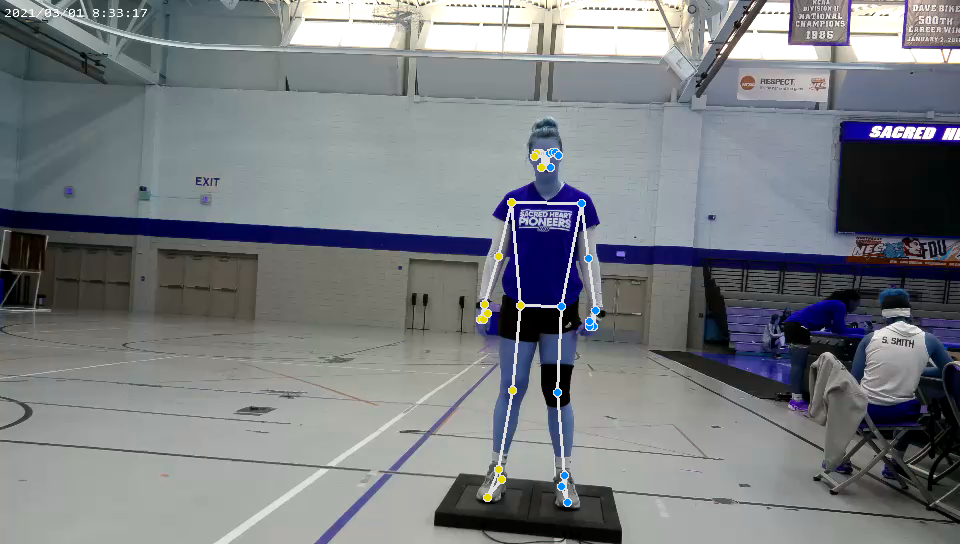


image size:  (544, 960, 3)
points_x_11:  582
points_y_11:  204
points_x_12:  513
points_y_12:  203
points_x_27:  564
points_y_27:  475
points_x_28:  499
points_y_28:  469


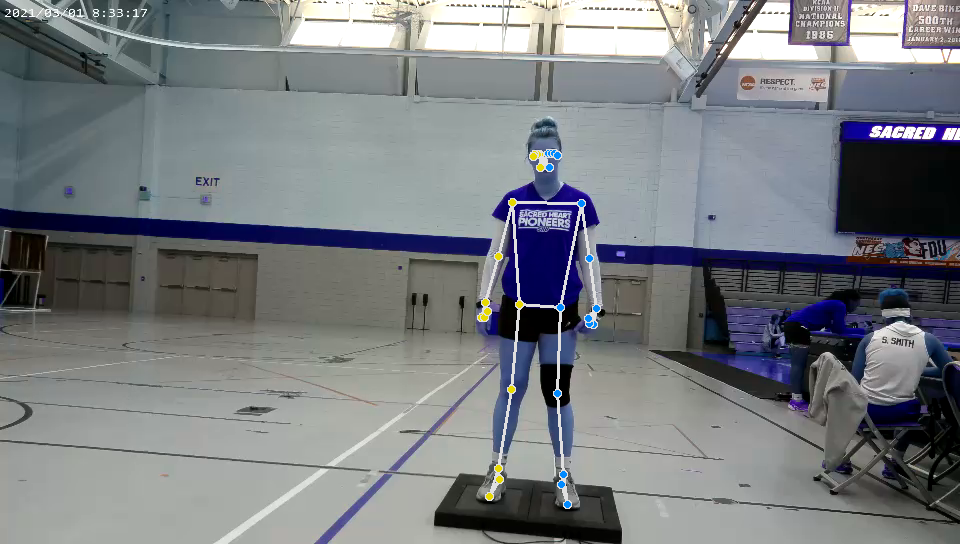


image size:  (544, 960, 3)
points_x_11:  582
points_y_11:  204
points_x_12:  513
points_y_12:  203
points_x_27:  565
points_y_27:  475
points_x_28:  499
points_y_28:  469


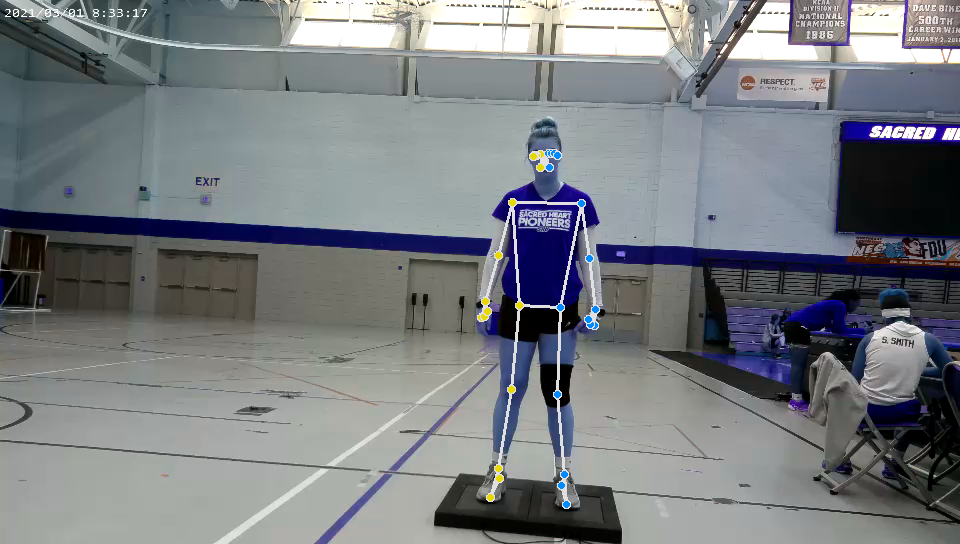


image size:  (544, 960, 3)
points_x_11:  582
points_y_11:  204
points_x_12:  512
points_y_12:  202
points_x_27:  564
points_y_27:  475
points_x_28:  499
points_y_28:  469


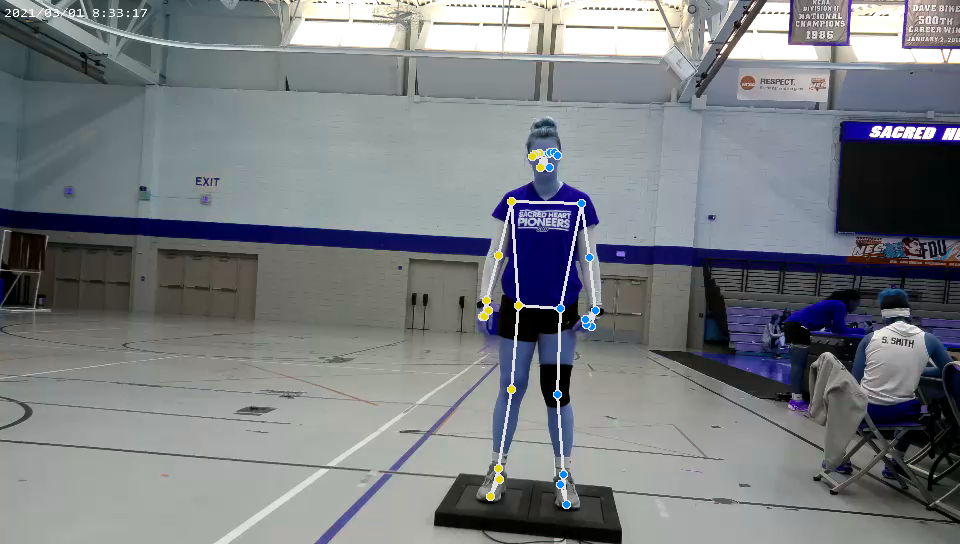


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  203
points_x_12:  512
points_y_12:  202
points_x_27:  565
points_y_27:  475
points_x_28:  499
points_y_28:  469


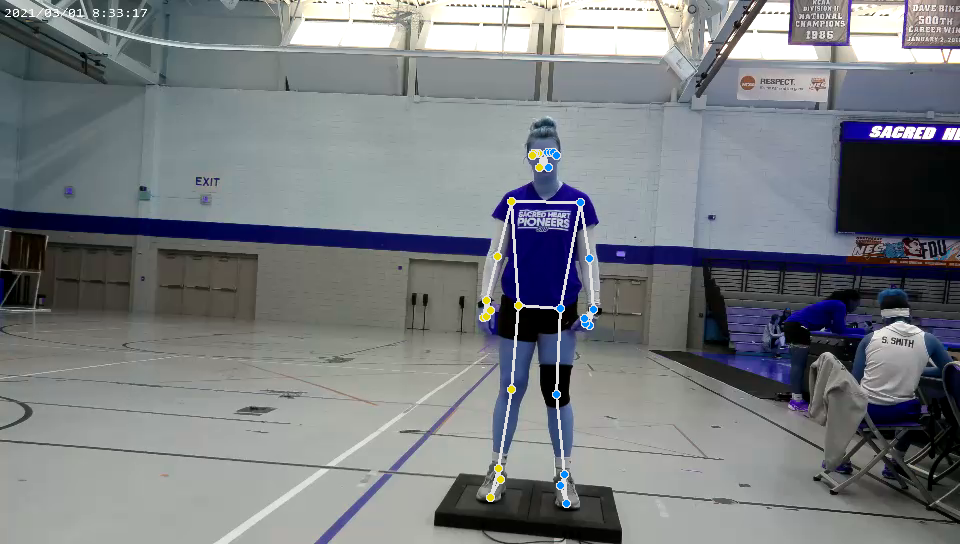


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  203
points_x_12:  512
points_y_12:  202
points_x_27:  564
points_y_27:  474
points_x_28:  499
points_y_28:  470


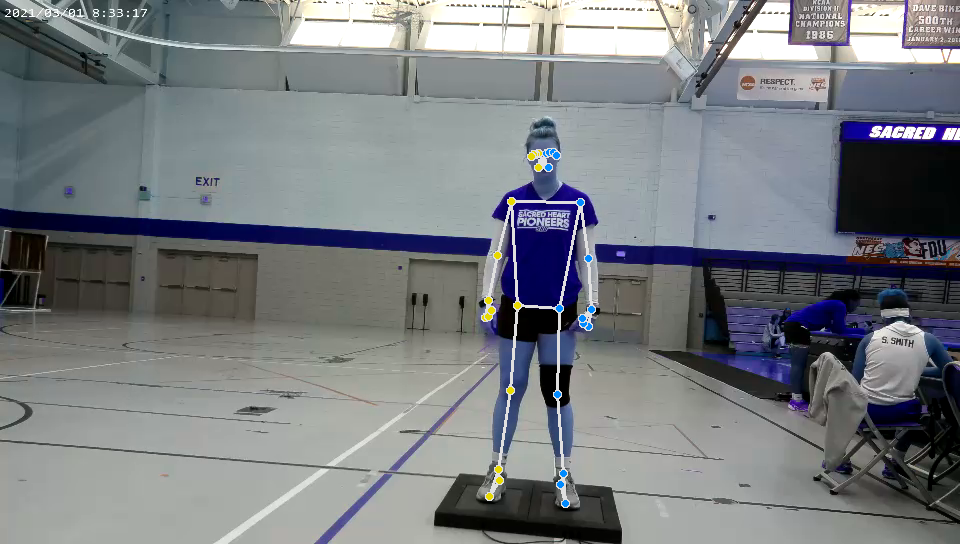


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  203
points_x_12:  511
points_y_12:  202
points_x_27:  566
points_y_27:  475
points_x_28:  498
points_y_28:  468


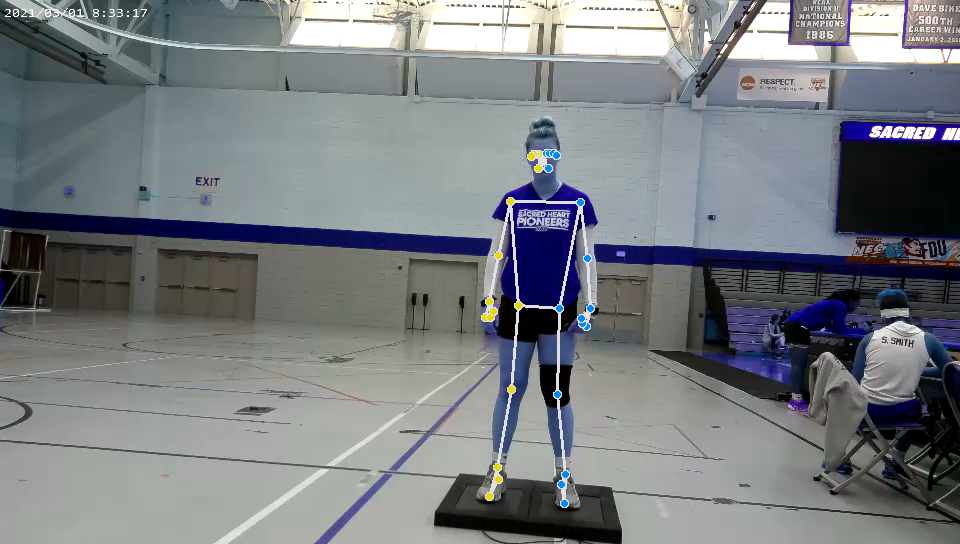


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  203
points_x_12:  511
points_y_12:  202
points_x_27:  564
points_y_27:  474
points_x_28:  499
points_y_28:  469


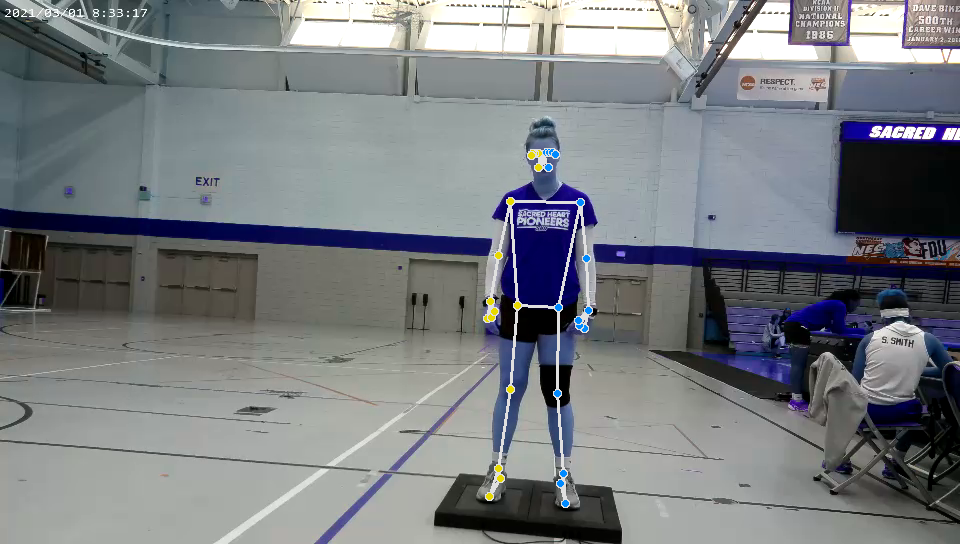


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  204
points_x_12:  511
points_y_12:  202
points_x_27:  565
points_y_27:  475
points_x_28:  498
points_y_28:  469


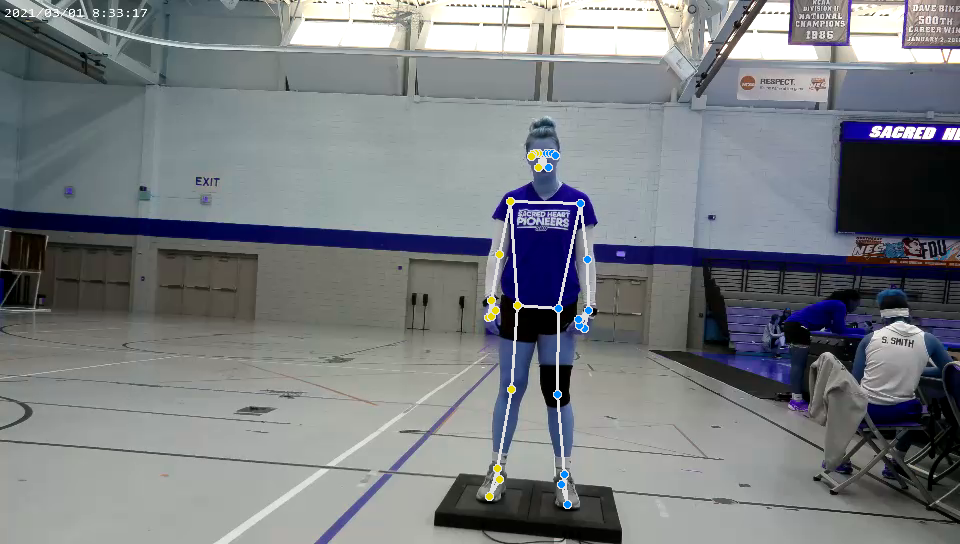


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  204
points_x_12:  511
points_y_12:  202
points_x_27:  566
points_y_27:  475
points_x_28:  498
points_y_28:  469


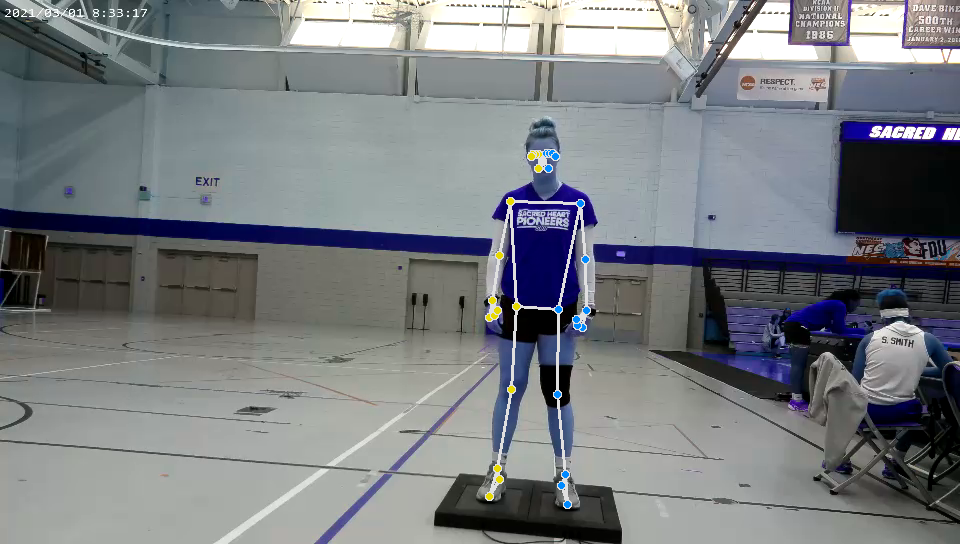


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  204
points_x_12:  511
points_y_12:  203
points_x_27:  565
points_y_27:  475
points_x_28:  498
points_y_28:  468


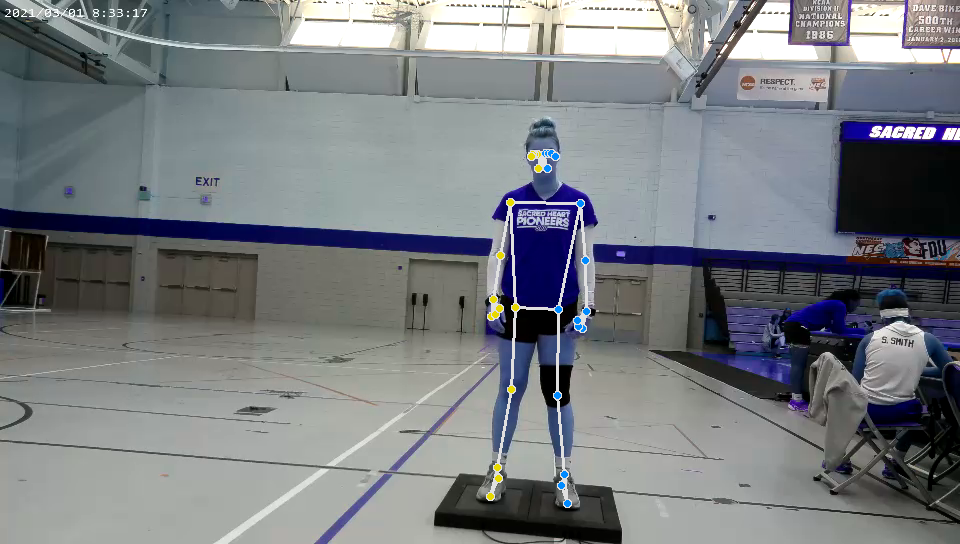


image size:  (544, 960, 3)
points_x_11:  580
points_y_11:  204
points_x_12:  511
points_y_12:  202
points_x_27:  565
points_y_27:  475
points_x_28:  498
points_y_28:  468


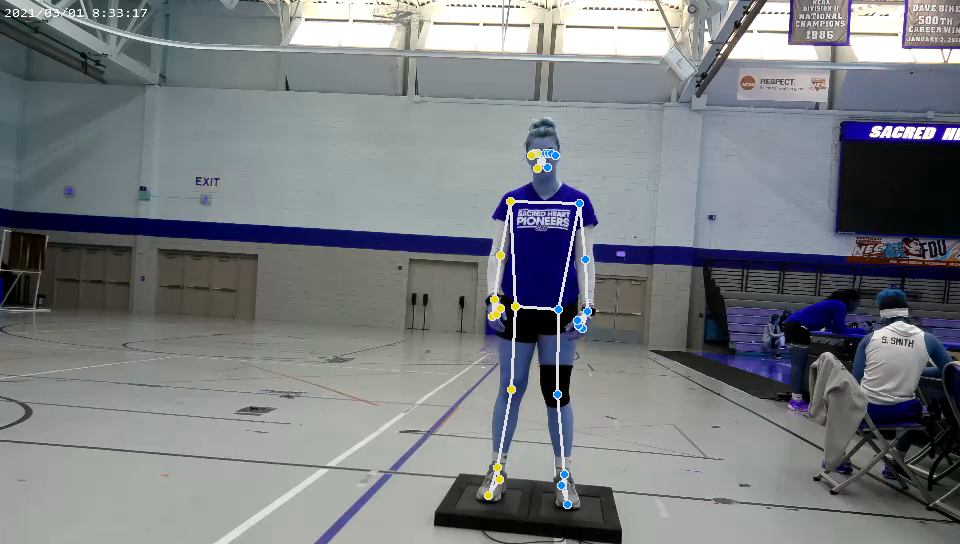


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  204
points_x_12:  511
points_y_12:  202
points_x_27:  565
points_y_27:  475
points_x_28:  498
points_y_28:  470


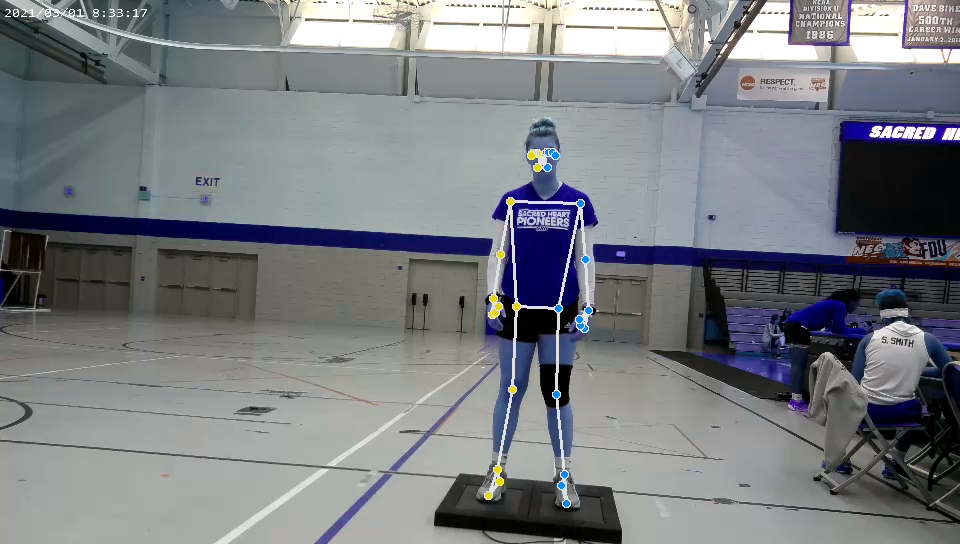


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  205
points_x_12:  510
points_y_12:  203
points_x_27:  565
points_y_27:  474
points_x_28:  498
points_y_28:  468


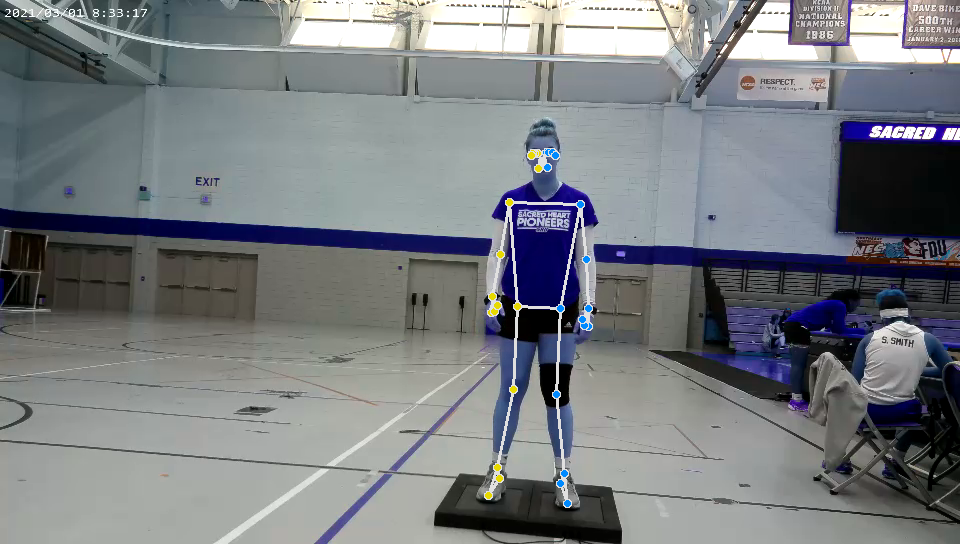


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  204
points_x_12:  510
points_y_12:  202
points_x_27:  565
points_y_27:  474
points_x_28:  499
points_y_28:  469


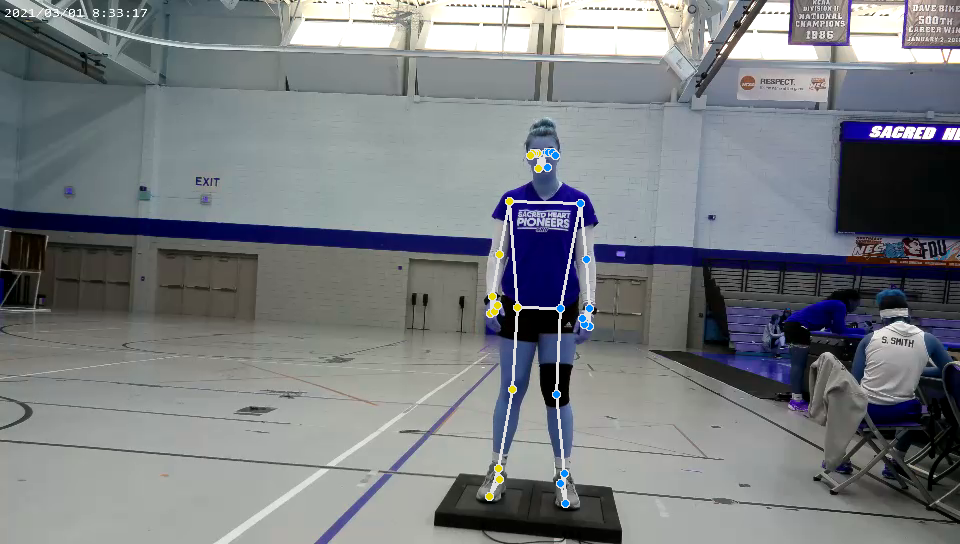


image size:  (544, 960, 3)
points_x_11:  582
points_y_11:  205
points_x_12:  510
points_y_12:  203
points_x_27:  564
points_y_27:  475
points_x_28:  499
points_y_28:  469


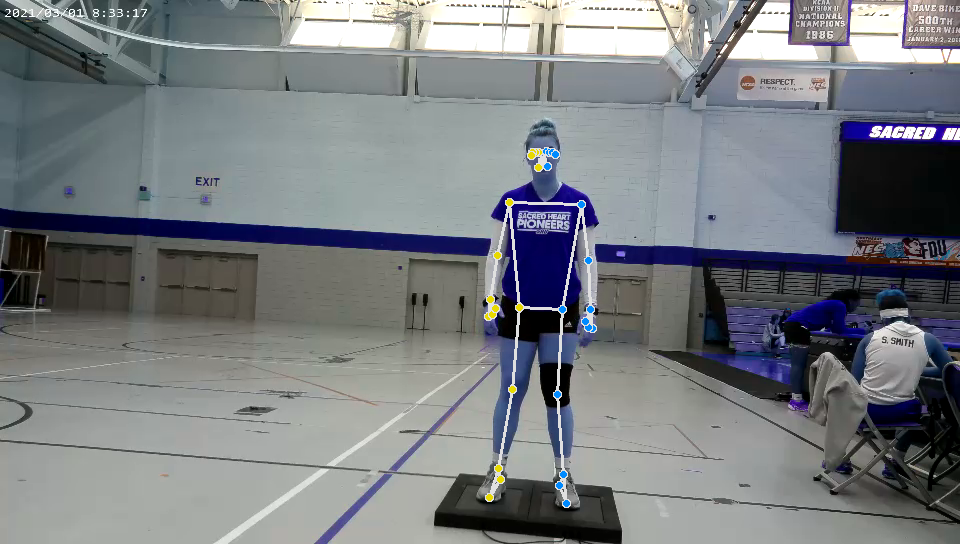


image size:  (544, 960, 3)
points_x_11:  582
points_y_11:  206
points_x_12:  510
points_y_12:  205
points_x_27:  564
points_y_27:  476
points_x_28:  499
points_y_28:  470


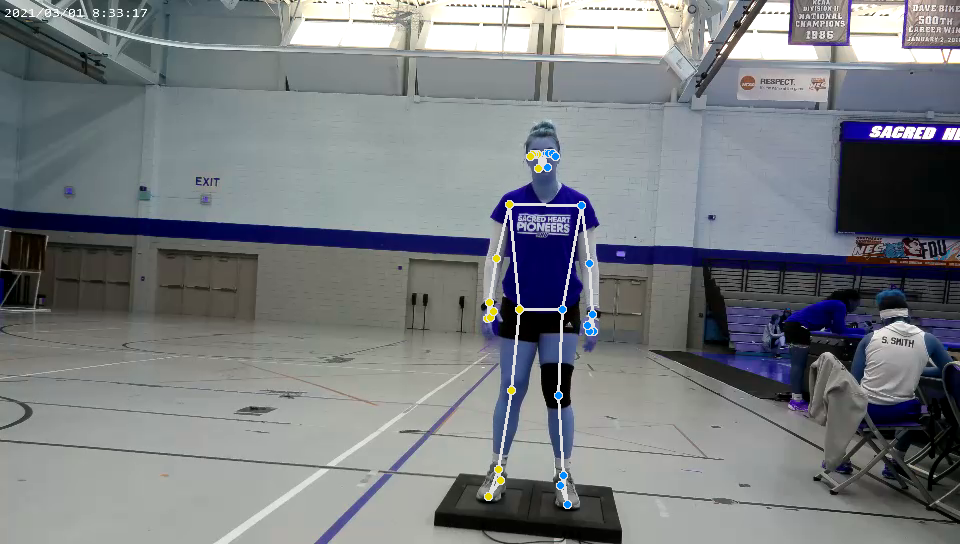


image size:  (544, 960, 3)
points_x_11:  582
points_y_11:  210
points_x_12:  509
points_y_12:  209
points_x_27:  564
points_y_27:  476
points_x_28:  500
points_y_28:  469


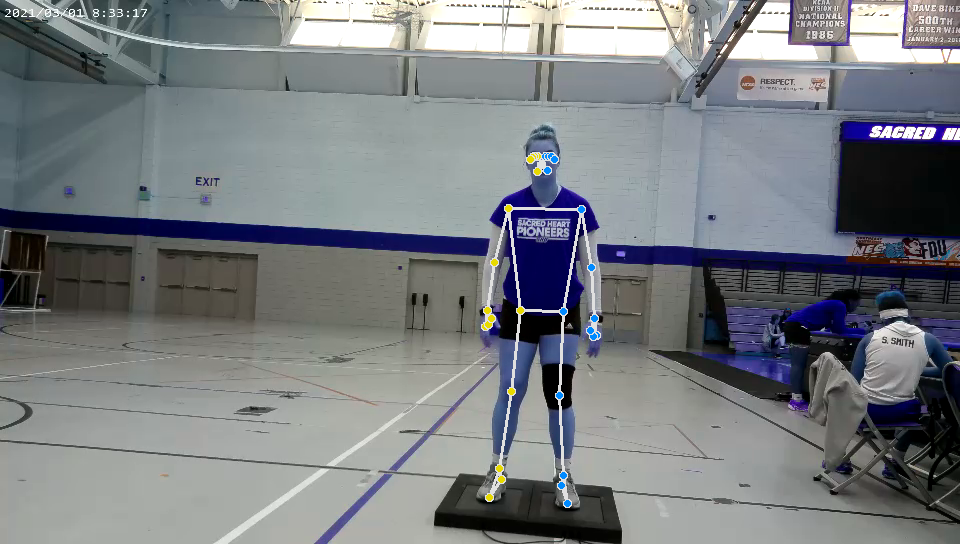


image size:  (544, 960, 3)
points_x_11:  582
points_y_11:  216
points_x_12:  509
points_y_12:  214
points_x_27:  564
points_y_27:  476
points_x_28:  500
points_y_28:  469


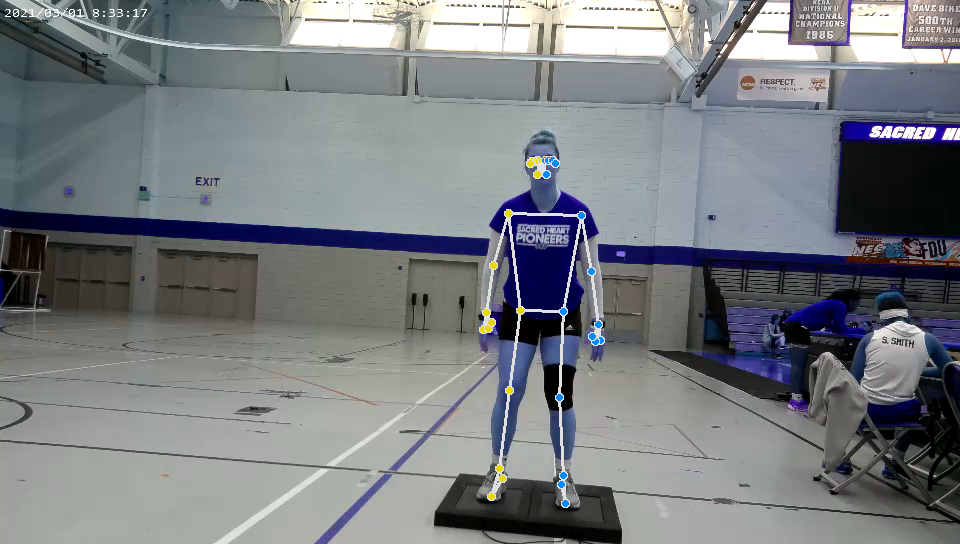


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  222
points_x_12:  509
points_y_12:  220
points_x_27:  564
points_y_27:  477
points_x_28:  500
points_y_28:  469


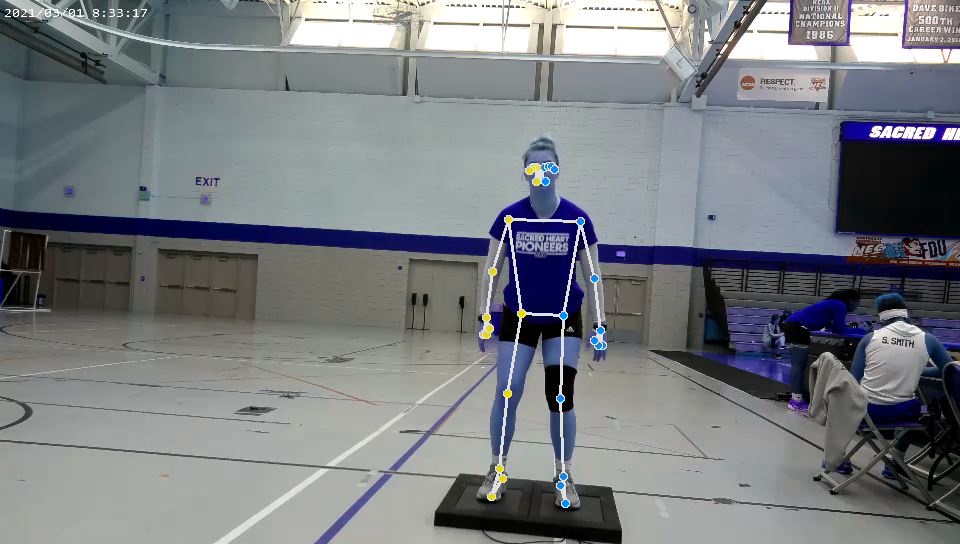


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  230
points_x_12:  508
points_y_12:  227
points_x_27:  564
points_y_27:  477
points_x_28:  500
points_y_28:  469


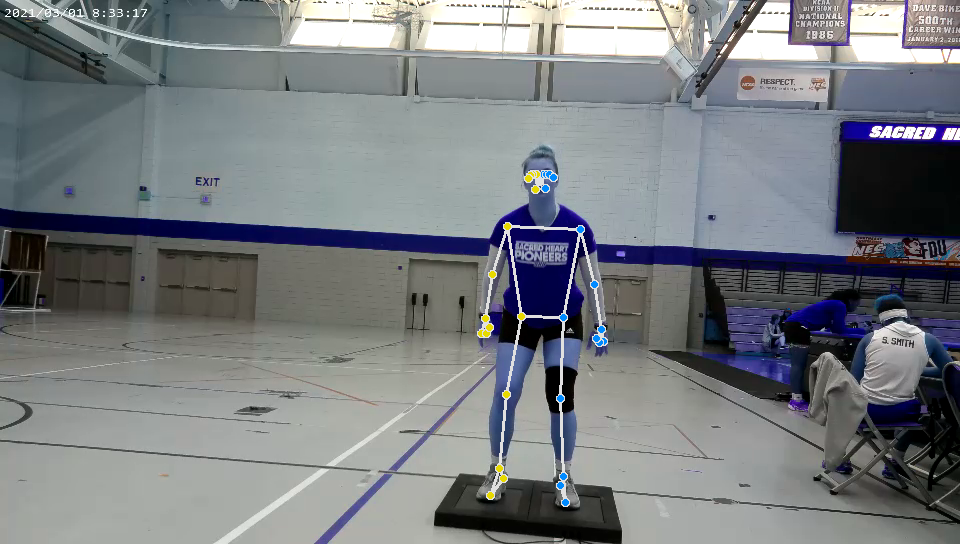


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  230
points_x_12:  508
points_y_12:  227
points_x_27:  564
points_y_27:  476
points_x_28:  498
points_y_28:  469


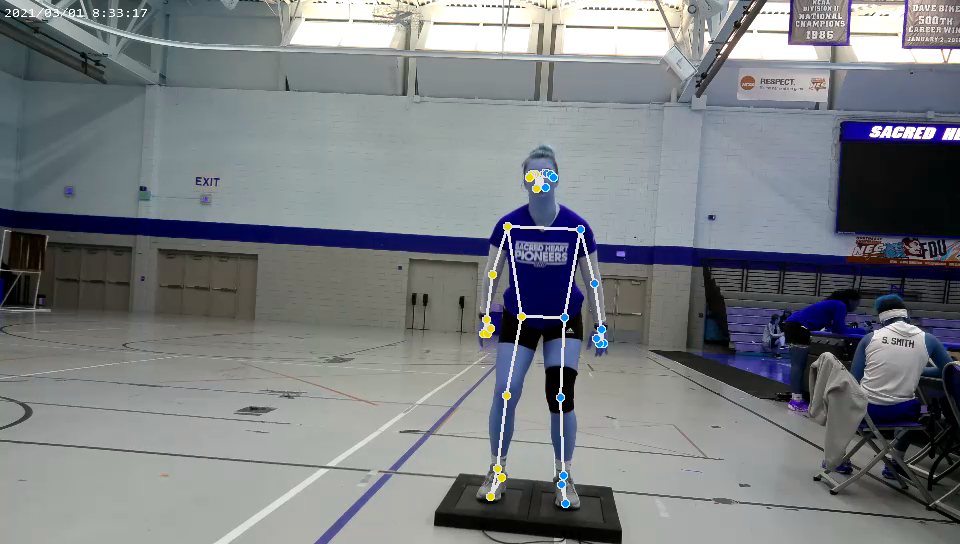


image size:  (544, 960, 3)
points_x_11:  579
points_y_11:  236
points_x_12:  509
points_y_12:  233
points_x_27:  564
points_y_27:  476
points_x_28:  498
points_y_28:  469


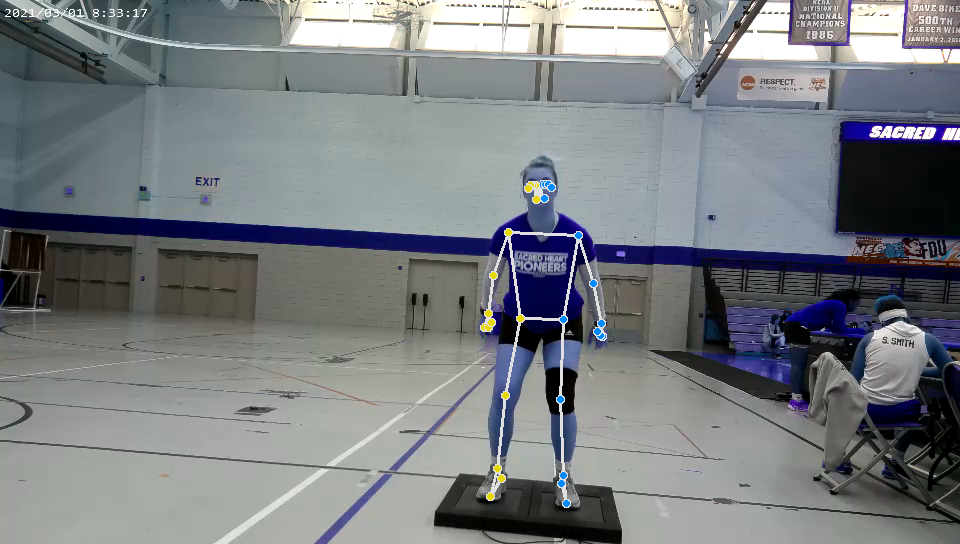


image size:  (544, 960, 3)
points_x_11:  577
points_y_11:  245
points_x_12:  509
points_y_12:  242
points_x_27:  564
points_y_27:  477
points_x_28:  498
points_y_28:  469


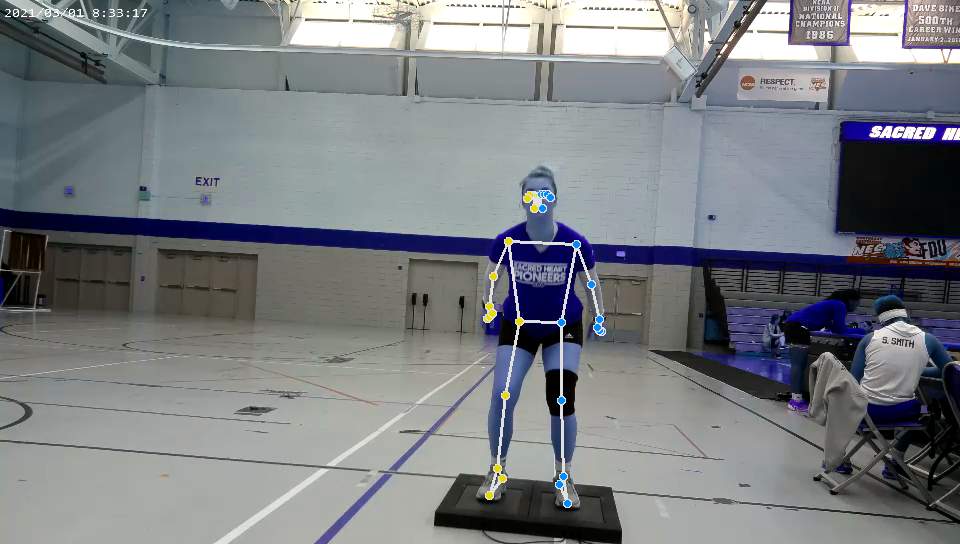


image size:  (544, 960, 3)
points_x_11:  576
points_y_11:  251
points_x_12:  506
points_y_12:  251
points_x_27:  564
points_y_27:  477
points_x_28:  499
points_y_28:  470


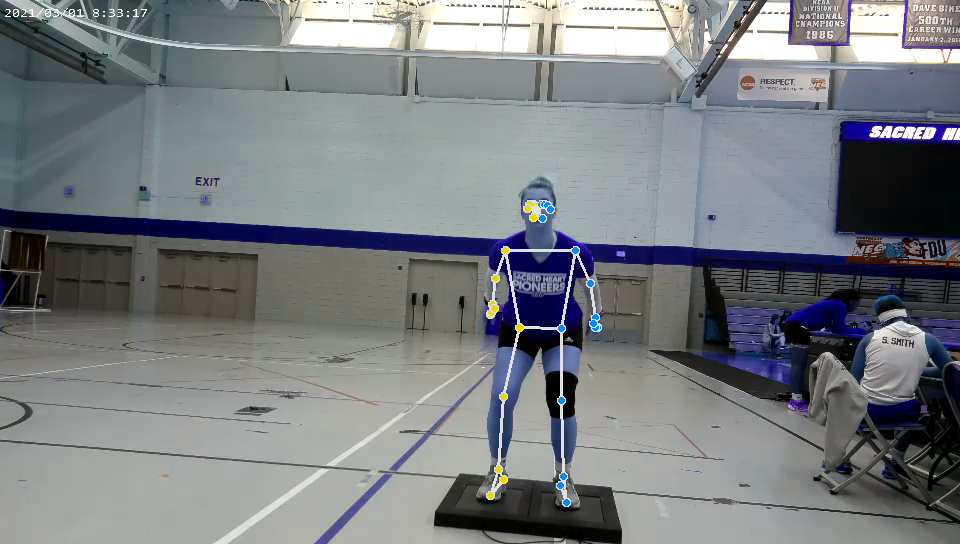


image size:  (544, 960, 3)
points_x_11:  578
points_y_11:  259
points_x_12:  505
points_y_12:  257
points_x_27:  564
points_y_27:  478
points_x_28:  497
points_y_28:  472


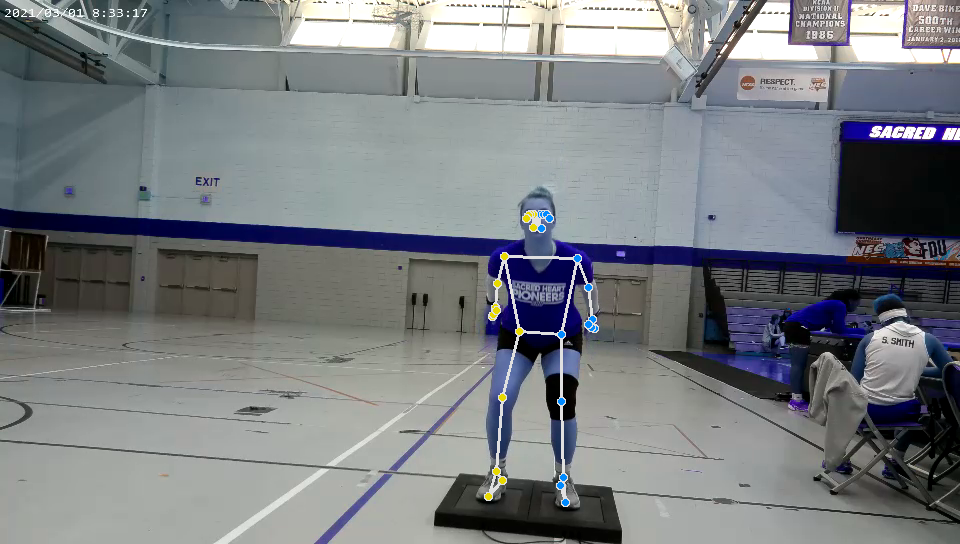


image size:  (544, 960, 3)
points_x_11:  578
points_y_11:  268
points_x_12:  503
points_y_12:  266
points_x_27:  564
points_y_27:  478
points_x_28:  497
points_y_28:  472


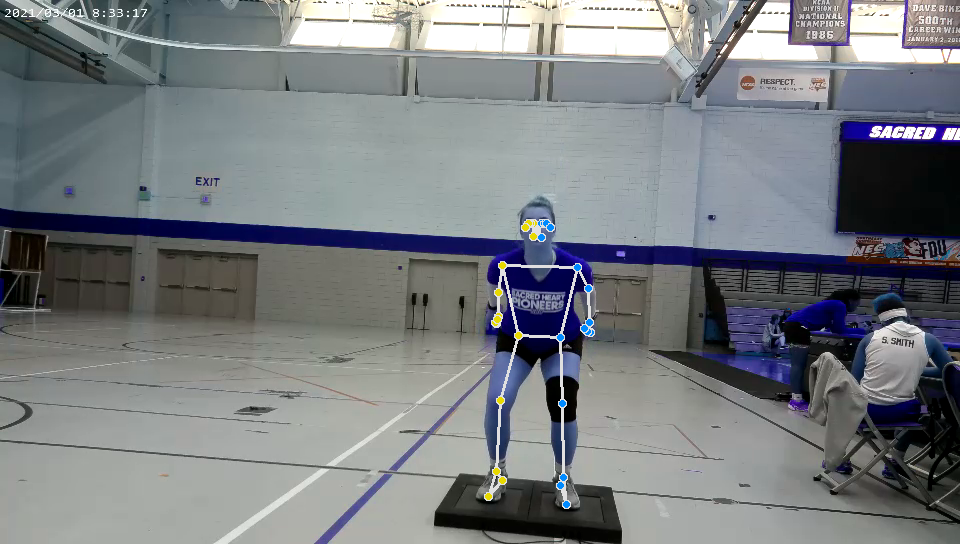


image size:  (544, 960, 3)
points_x_11:  578
points_y_11:  269
points_x_12:  503
points_y_12:  265
points_x_27:  564
points_y_27:  477
points_x_28:  498
points_y_28:  473


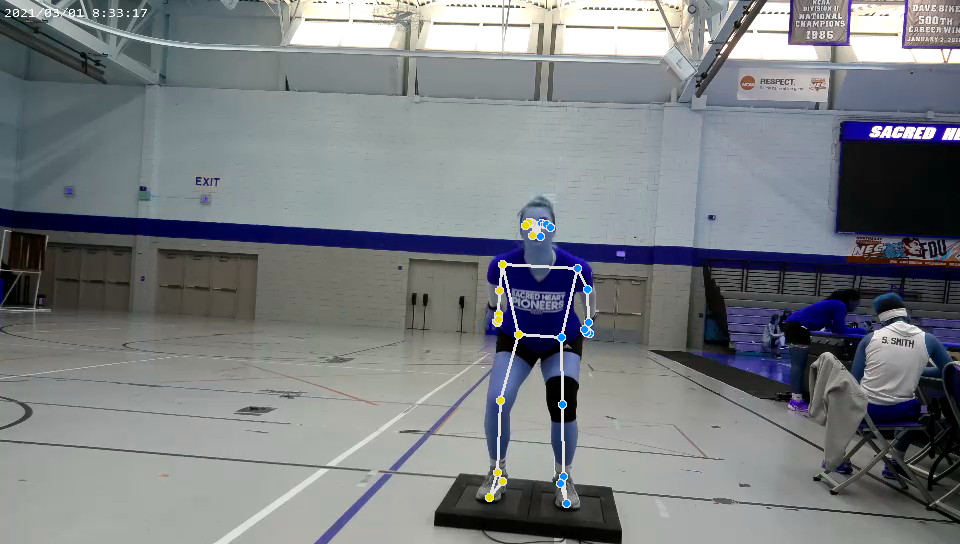


image size:  (544, 960, 3)
points_x_11:  581
points_y_11:  278
points_x_12:  502
points_y_12:  274
points_x_27:  564
points_y_27:  478
points_x_28:  498
points_y_28:  472


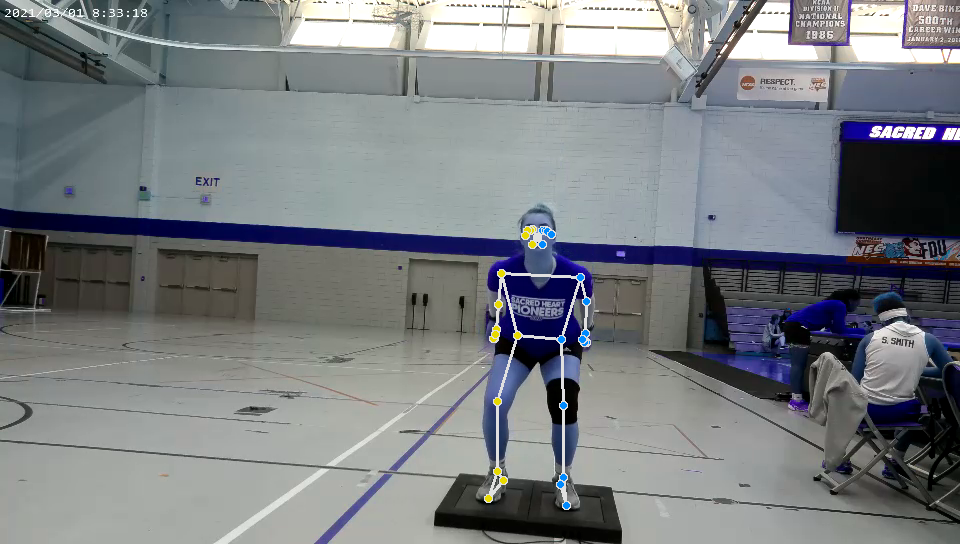


image size:  (544, 960, 3)
points_x_11:  580
points_y_11:  281
points_x_12:  504
points_y_12:  276
points_x_27:  564
points_y_27:  477
points_x_28:  499
points_y_28:  472


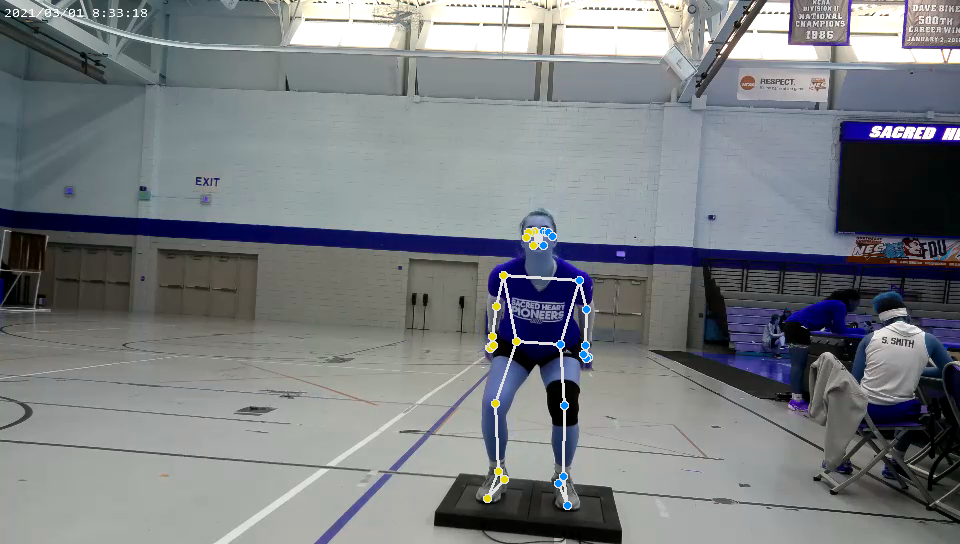


image size:  (544, 960, 3)
points_x_11:  579
points_y_11:  280
points_x_12:  506
points_y_12:  275
points_x_27:  563
points_y_27:  475
points_x_28:  499
points_y_28:  470


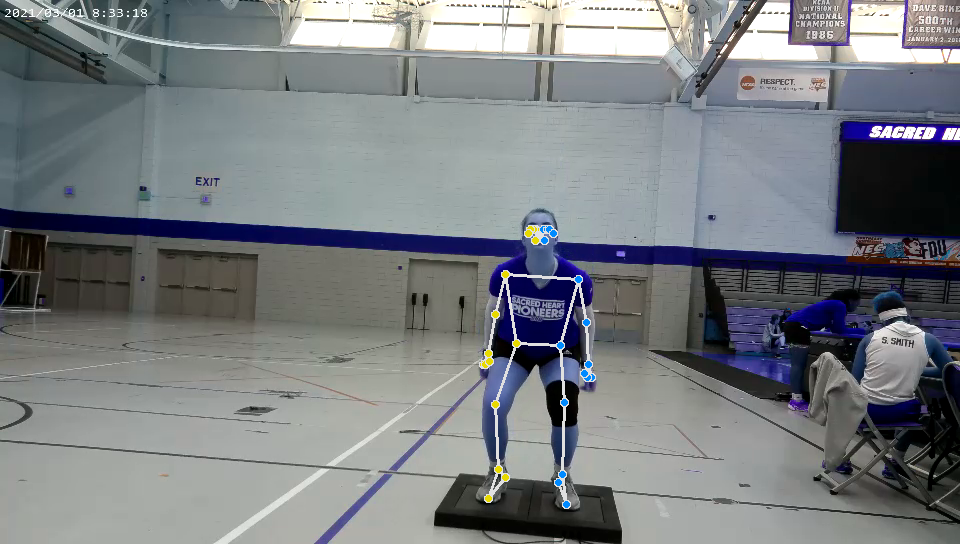


image size:  (544, 960, 3)
points_x_11:  577
points_y_11:  277
points_x_12:  507
points_y_12:  269
points_x_27:  562
points_y_27:  475
points_x_28:  499
points_y_28:  470


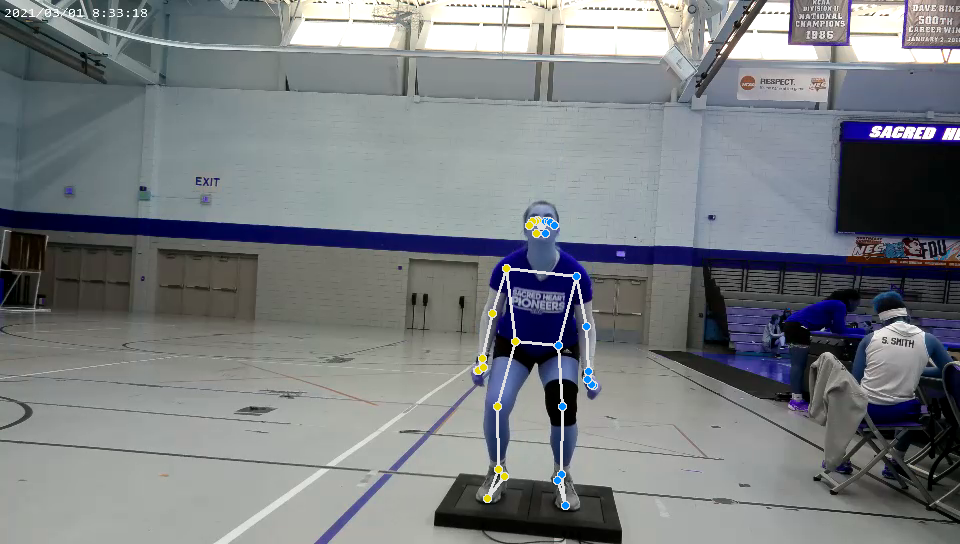


image size:  (544, 960, 3)
points_x_11:  578
points_y_11:  265
points_x_12:  511
points_y_12:  257
points_x_27:  564
points_y_27:  475
points_x_28:  499
points_y_28:  471


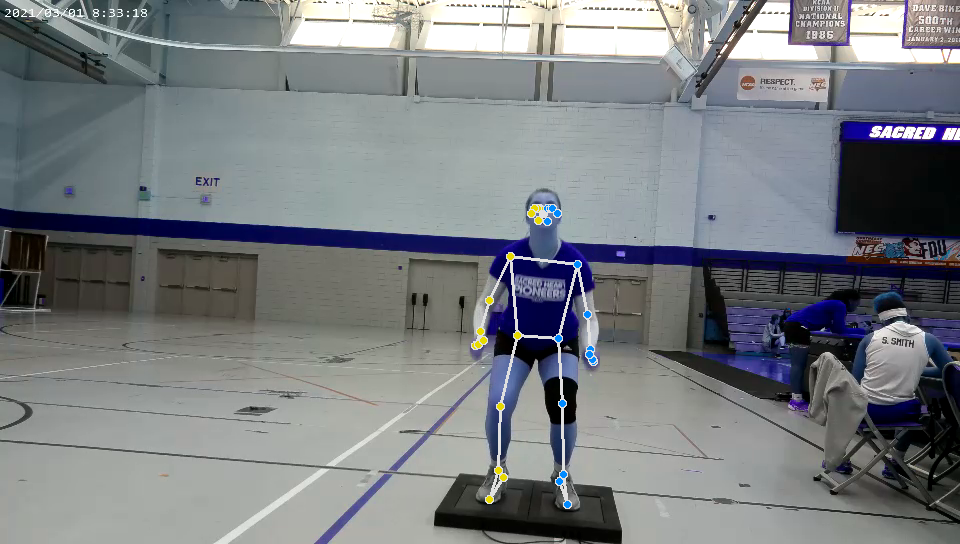


image size:  (544, 960, 3)
points_x_11:  578
points_y_11:  265
points_x_12:  511
points_y_12:  257
points_x_27:  563
points_y_27:  474
points_x_28:  499
points_y_28:  471


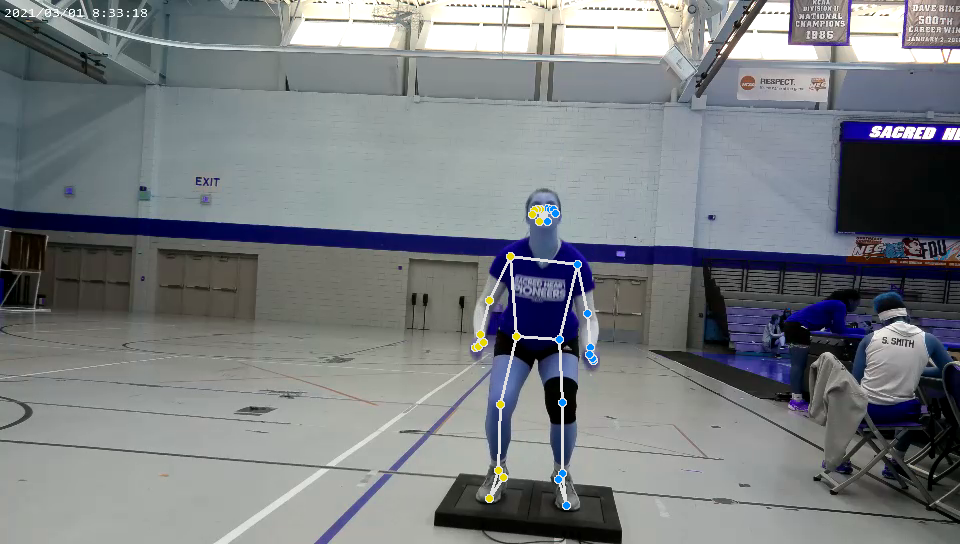


image size:  (544, 960, 3)
points_x_11:  578
points_y_11:  248
points_x_12:  511
points_y_12:  244
points_x_27:  563
points_y_27:  473
points_x_28:  500
points_y_28:  469


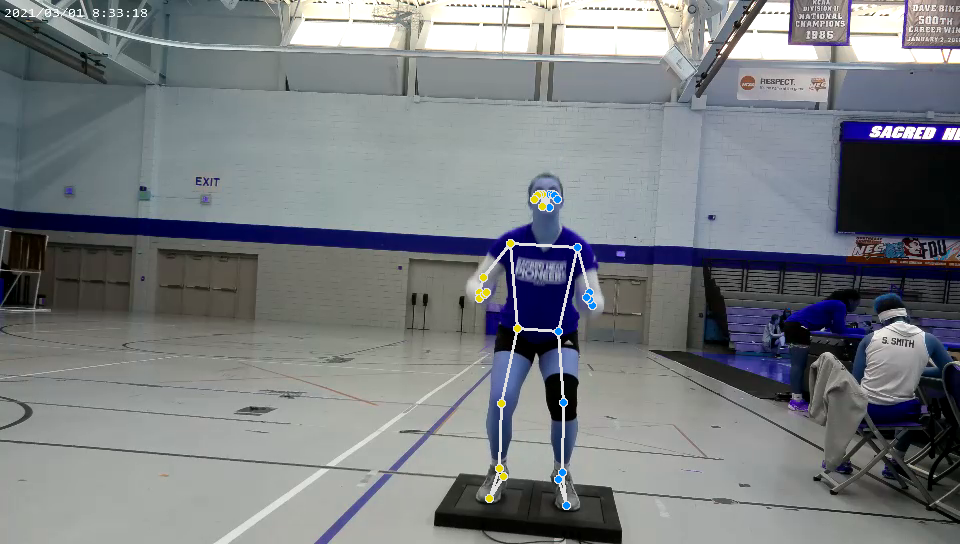


image size:  (544, 960, 3)
points_x_11:  579
points_y_11:  228
points_x_12:  512
points_y_12:  225
points_x_27:  564
points_y_27:  473
points_x_28:  500
points_y_28:  468


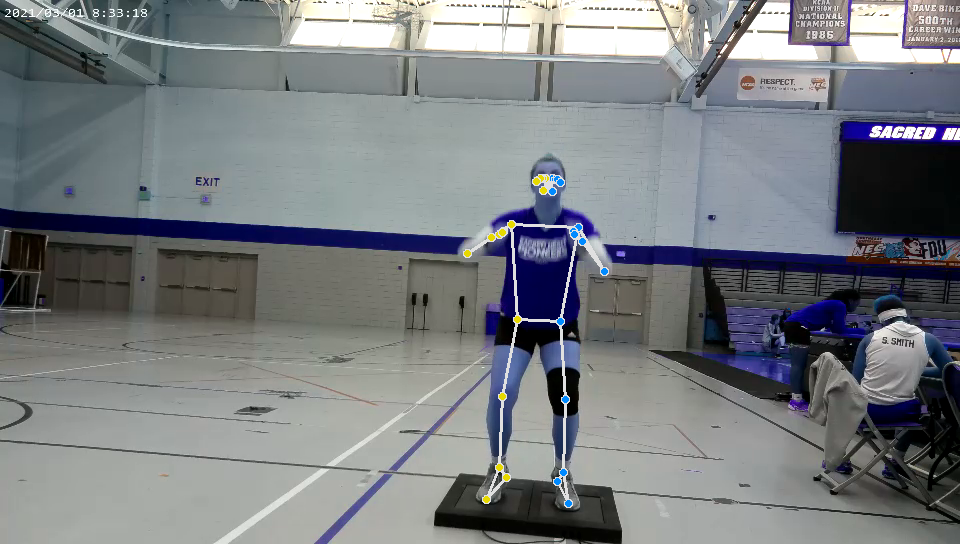


image size:  (544, 960, 3)
points_x_11:  578
points_y_11:  203
points_x_12:  516
points_y_12:  196
points_x_27:  566
points_y_27:  471
points_x_28:  499
points_y_28:  465


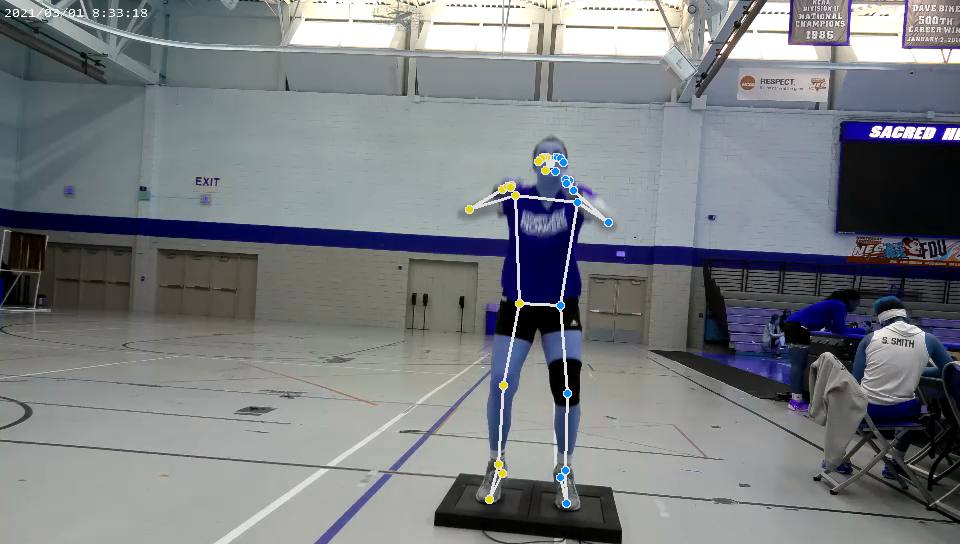


image size:  (544, 960, 3)
points_x_11:  578
points_y_11:  177
points_x_12:  518
points_y_12:  174
points_x_27:  569
points_y_27:  461
points_x_28:  496
points_y_28:  456


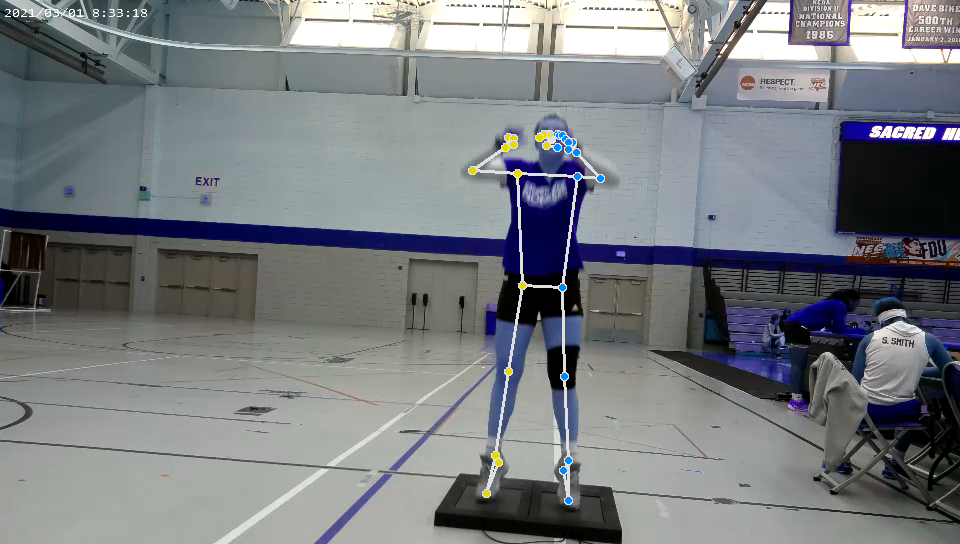


image size:  (544, 960, 3)
points_x_11:  580
points_y_11:  156
points_x_12:  520
points_y_12:  152
points_x_27:  568
points_y_27:  442
points_x_28:  499
points_y_28:  434


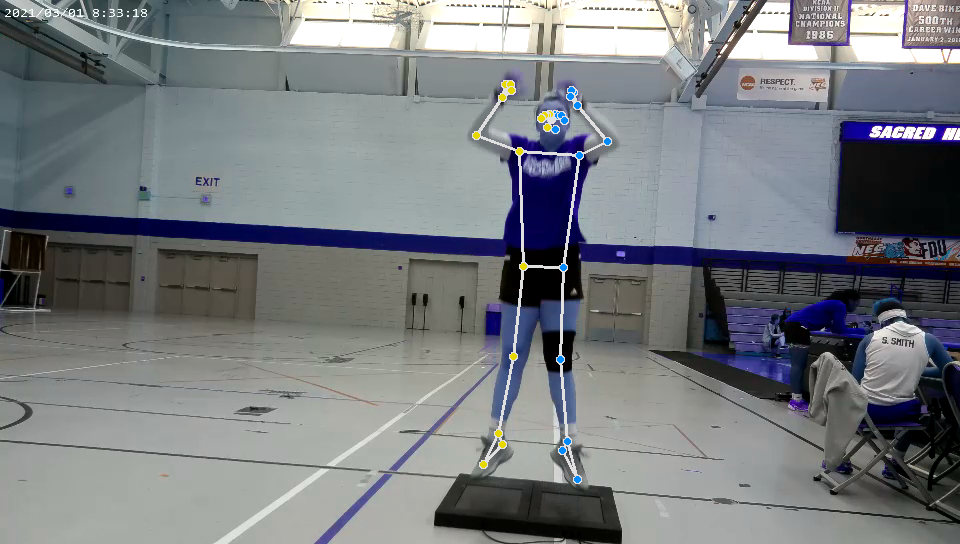


image size:  (544, 960, 3)
points_x_11:  580
points_y_11:  156
points_x_12:  520
points_y_12:  152
points_x_27:  568
points_y_27:  441
points_x_28:  499
points_y_28:  435


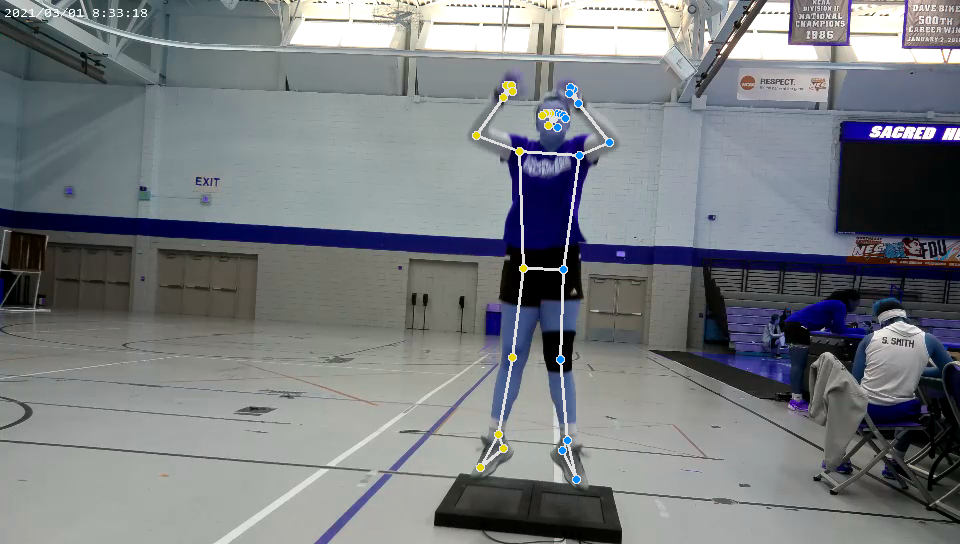


image size:  (544, 960, 3)
points_x_11:  583
points_y_11:  141
points_x_12:  520
points_y_12:  137
points_x_27:  564
points_y_27:  428
points_x_28:  506
points_y_28:  423


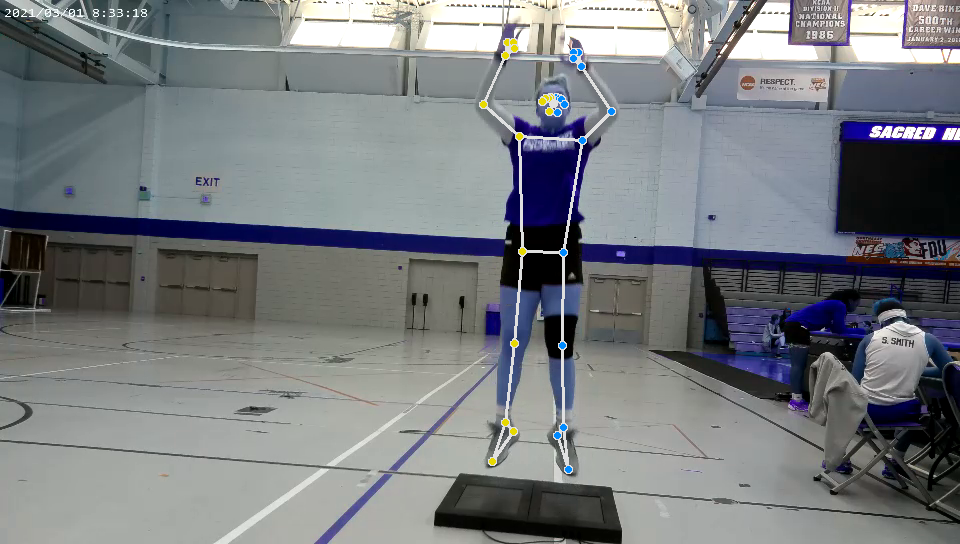


image size:  (544, 960, 3)
points_x_11:  584
points_y_11:  126
points_x_12:  522
points_y_12:  123
points_x_27:  562
points_y_27:  416
points_x_28:  510
points_y_28:  413


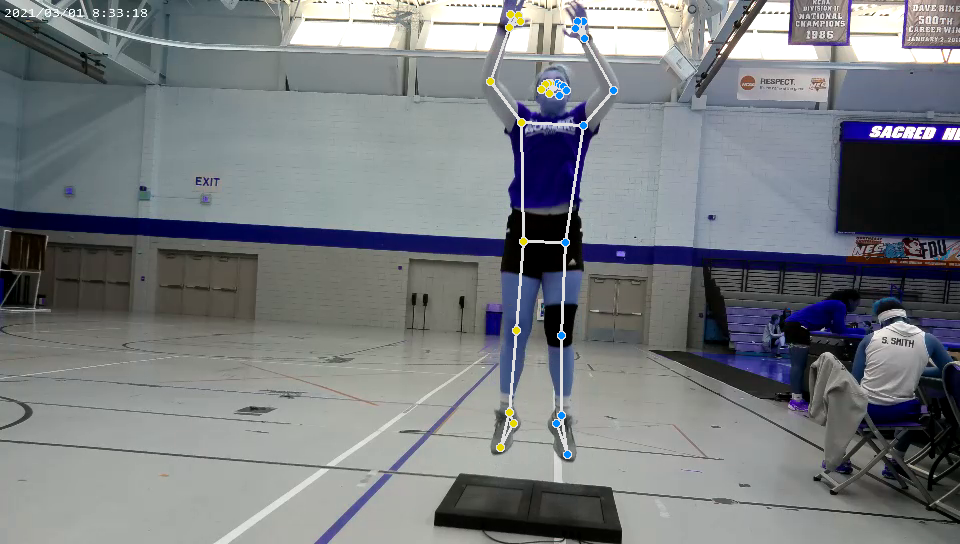


image size:  (544, 960, 3)
points_x_11:  586
points_y_11:  114
points_x_12:  523
points_y_12:  114
points_x_27:  563
points_y_27:  408
points_x_28:  510
points_y_28:  404


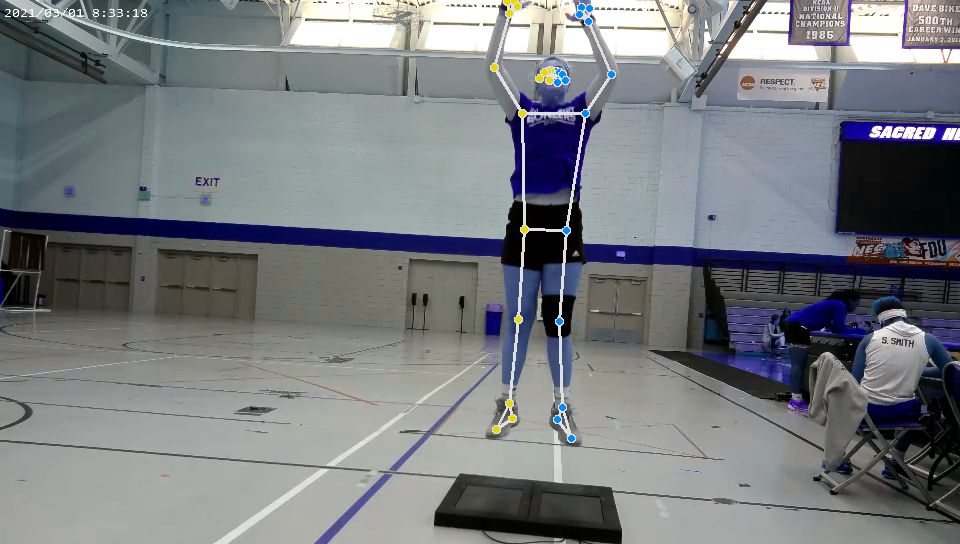


image size:  (544, 960, 3)
points_x_11:  586
points_y_11:  108
points_x_12:  524
points_y_12:  106
points_x_27:  563
points_y_27:  403
points_x_28:  510
points_y_28:  397


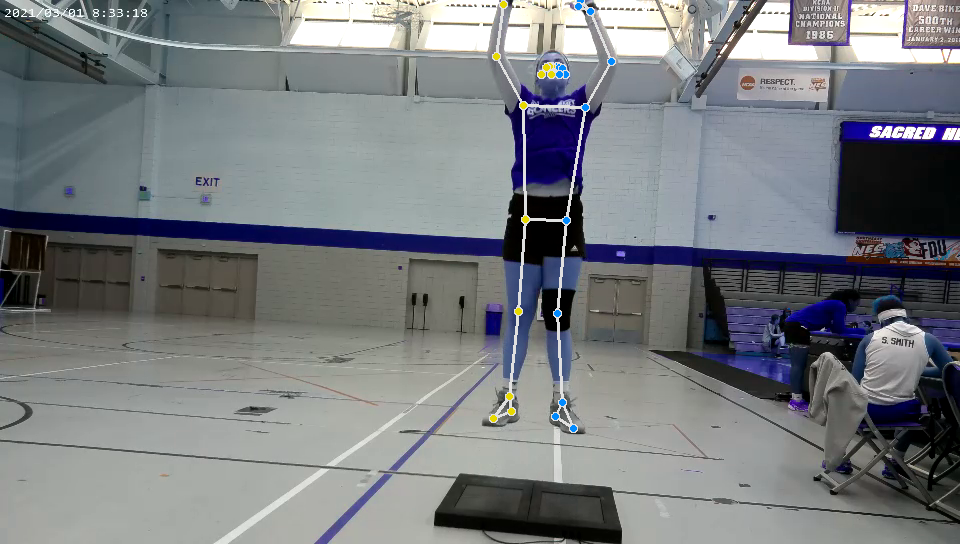


image size:  (544, 960, 3)
points_x_11:  585
points_y_11:  106
points_x_12:  523
points_y_12:  102
points_x_27:  562
points_y_27:  398
points_x_28:  511
points_y_28:  393


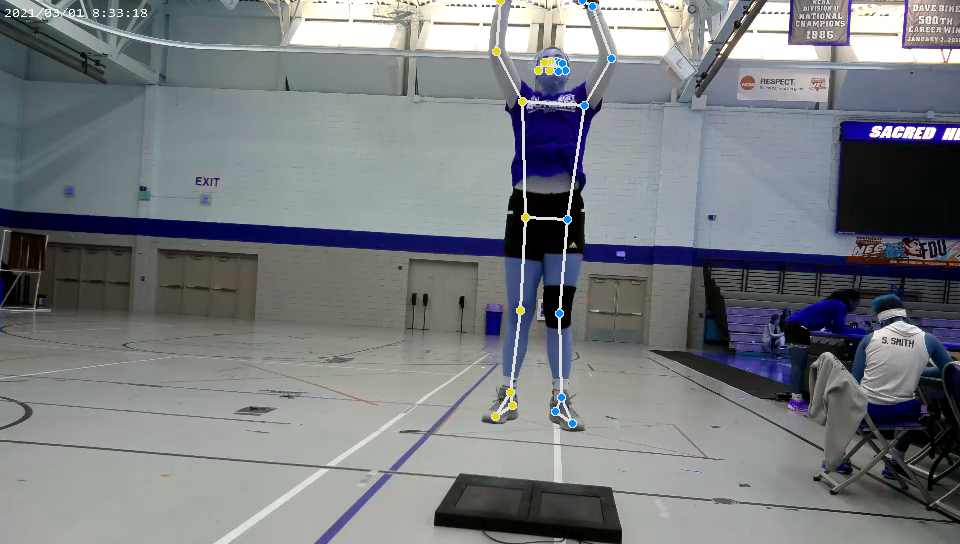

In [ ]:
import mediapipe as mp
from mediapipe.tasks import python
from mediapipe.tasks.python import vision
from google.colab.patches import cv2_imshow
import time

BaseOptions = mp.tasks.BaseOptions
PoseLandmarker = mp.tasks.vision.PoseLandmarker
PoseLandmarkerOptions = mp.tasks.vision.PoseLandmarkerOptions
VisionRunningMode = mp.tasks.vision.RunningMode

# Create a pose landmarker instance with the video mode:
options = PoseLandmarkerOptions(
    base_options=BaseOptions(model_asset_path='pose_landmarker.task'),
    running_mode=VisionRunningMode.VIDEO)

with PoseLandmarker.create_from_options(options) as landmarker:
  # The landmarker is initialized. Use it here.
  # ...
    cnt=0
    while cap.isOpened():
        # Capture frame-by-frame
        ret, frame = cap.read()
        if not ret:
            break

        print("image size: ",frame.shape)
        # Convert the frame to MediaPipe's Image object
        # MediaPipe requires the frame in RGB format
        # If the frame is in BGR format, convert it to RGB
        if frame.shape[2] == 3:  # If it's a color image (not grayscale)
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        else:  # If it's grayscale
            frame_rgb = cv2.cvtColor(frame, cv2.COLOR_GRAY2RGB)

        # Convert the frame to numpy array
        numpy_frame_from_opencv = np.array(frame_rgb)
        # Convert the frame received from OpenCV to a MediaPipe’s Image object.
        mp_image = mp.Image(image_format=mp.ImageFormat.SRGB, data=numpy_frame_from_opencv)

        # print("image size: ",frame_rgb.size)
# Update the data of MediaPipe's image object
# mp_image.data = numpy_frame_from_opencv


        # Get the frame timestamp in milliseconds
        # frame_timestamp_ms = cap.get(cv2.CAP_PROP_POS_MSEC)
        # frame_timestamp_sec = frame_timestamp_ms / 1000.0

        # # Create a Timestamp object from seconds
        # timestamp = mp.Timestamp.FromSeconds(frame_timestamp_sec)
        # timestamp = mp.Timestamp(frame_timestamp_ms*1000)
        # Perform pose landmarking on the provided single image.
        # The pose landmarker must be created with the video mode.

        timestamp = mp.Timestamp.from_seconds(time.time()).value
        pose_landmarker_result = landmarker.detect_for_video(image=mp_image, timestamp_ms=timestamp)
        print("points_x_11: ", math.ceil(pose_landmarker_result.pose_landmarks[0][11].x*960))
        print("points_y_11: ", math.ceil(pose_landmarker_result.pose_landmarks[0][11].y*544))
        print("points_x_12: ", math.ceil(pose_landmarker_result.pose_landmarks[0][12].x*960))
        print("points_y_12: ", math.ceil(pose_landmarker_result.pose_landmarks[0][12].y*544))

        print("points_x_27: ", math.ceil(pose_landmarker_result.pose_landmarks[0][27].x*960))
        print("points_y_27: ", math.ceil(pose_landmarker_result.pose_landmarks[0][27].y*544))
        print("points_x_28: ", math.ceil(pose_landmarker_result.pose_landmarks[0][28].x*960))
        print("points_y_28: ", math.ceil(pose_landmarker_result.pose_landmarks[0][28].y*544))

        # Display the frame (optional)

        annotated_image = draw_landmarks_on_image(frame, pose_landmarker_result)
        cv2_imshow(cv2.cvtColor(annotated_image, cv2.COLOR_RGB2BGR))
        # cv2_imshow(frame)
        print()
        cnt+=1
        if cnt == 45:
          break
        # Break the loop if 'q' is pressed
        if cv2.waitKey(25) & 0xFF == ord('q'):
            break

# Release the video capture object and close the OpenCV windows
cap.release()
cv2.destroyAllWindows()